# Esercizio serie storica  

Questo secondo esercizio richiede di effettuare un'analisi di dati di serie storica.

Leggendo il dataset data/globaltemperatures.csv, caricare i dati della media della temperatura nei diversi mesi dell'anno dal 1750. Plottare la serie dati, analizarne le caratteristiche (tendenza e stagionalità) e provare a fare una regressione lineare del trend (per valutarne la tendenza). Per fare regressione lineare di una timeseries è conveniente trasformare l'indice (l'asse X) in un numero che indica il numero di periodi passati dal momento inziale.

Infine provare a usare la serie storica per produrre le temperature dei successivi 10 anni.

In [1]:
import pandas as pd
import sys
import os 
import matplotlib.pyplot as plt
import numpy as np
import datetime as dt
from statsmodels.tsa.seasonal import seasonal_decompose
from dateutil.parser import parse
from statsmodels.tsa.stattools import adfuller
import statsmodels.api as sm
import pmdarima as pm



sys.path.append('../')

In [2]:
data = pd.read_csv('../data/globaltemperatures.csv', parse_dates=['dt'], index_col='dt')
data = data[['LandAverageTemperature']]

## Gestione dei valori nulli

In [3]:
data_missing = data[data['LandAverageTemperature'].isnull()]
print("L'intervallo temporale dei valori nulli va dal " + str(data_missing.index.min()) + " al " + str(data_missing.index.max()) 
      + ".\nSi riportano i valori nulli \n" + str(data_missing.head(15).reset_index()))

L'intervallo temporale dei valori nulli va dal 1750-11-01 00:00:00 al 1752-09-01 00:00:00.
Si riportano i valori nulli 
           dt  LandAverageTemperature
0  1750-11-01                     NaN
1  1751-05-01                     NaN
2  1751-07-01                     NaN
3  1751-10-01                     NaN
4  1751-11-01                     NaN
5  1751-12-01                     NaN
6  1752-02-01                     NaN
7  1752-05-01                     NaN
8  1752-06-01                     NaN
9  1752-07-01                     NaN
10 1752-08-01                     NaN
11 1752-09-01                     NaN


Per fillare i valori nulli si è deciso si usare la tecnica classica **Forward Fill**. Questa tecnica prevede l'inserimento dell'ultimo valore disponibile per tutti i valori nulli, verrà propagato l'ultima osservazione valida per tutti i valori nulli

La funzione Pandas dataframe.ffill() viene utilizzata per riempire il valore mancante nel dataframe. 'ffill' sta per 'riempimento in avanti' e propagherà l'ultima osservazione valida in avanti.

https://www.geeksforgeeks.org/python-pandas-dataframe-ffill/

In [4]:
data = data.ffill()

## Rappresentazione delle serie storica

In [7]:
plt.rcParams.update({'figure.figsize': (100, 50)})

### Rappresentazione standard

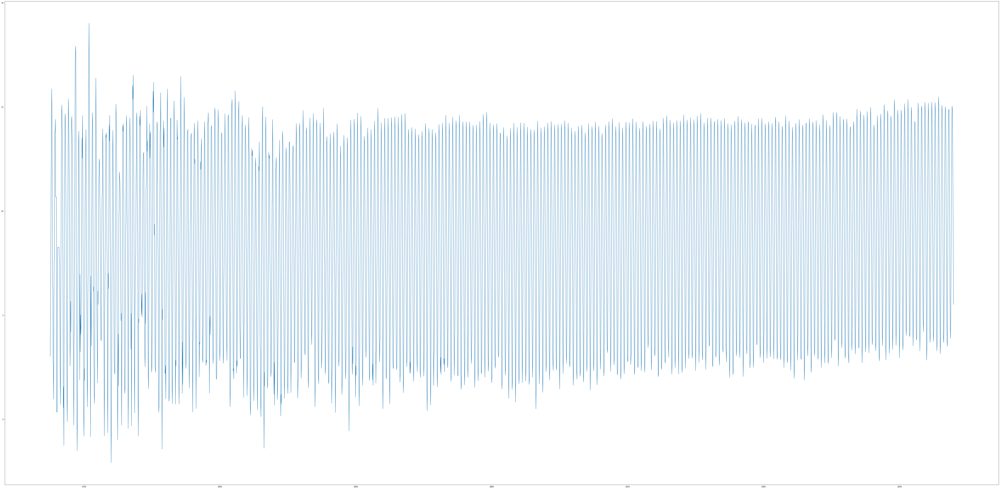

In [8]:
plt.plot(data.index, data.values)
plt.show()

### Rappresentazione two-sided view
*Time Series appaiata su se stessa*

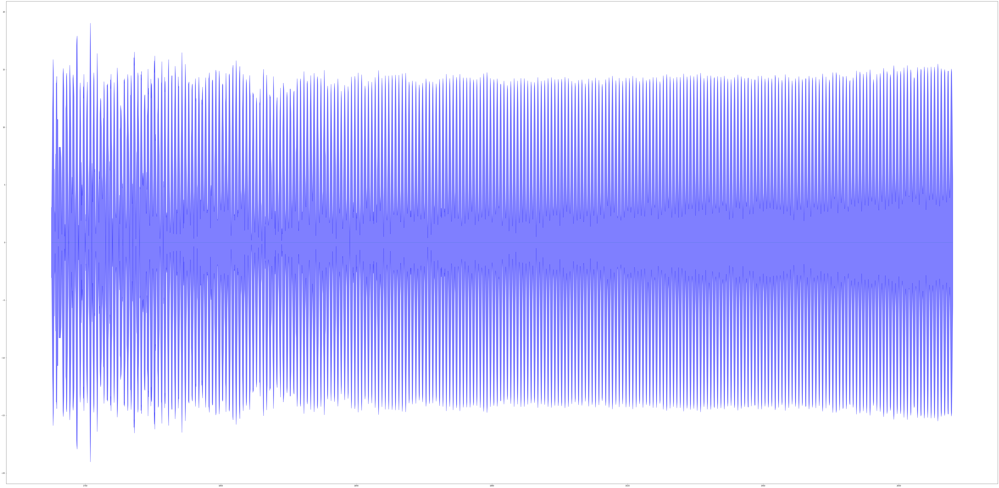

In [9]:
plt.fill_between(data.index, y1=np.array(data.LandAverageTemperature), \
                 y2=np.array(-data.LandAverageTemperature), alpha=0.5, linewidth=2, color='blue')
plt.hlines(y=0, xmin=np.min(data.index), xmax=np.max(data.index), linewidth=.5)
plt.show()

Dai due differenti plot sembrerebbe essere una serie storica in cui è visibile sia la componente della stagionalità che quella del trend

## Caratteristiche della serie storica (tendenza, stagionalità e stazionarietà)

### Scomposizione delle serie storica

#### Additive Decomposition 
$$Value = Base Level + Trend + Seasonality + Error$$

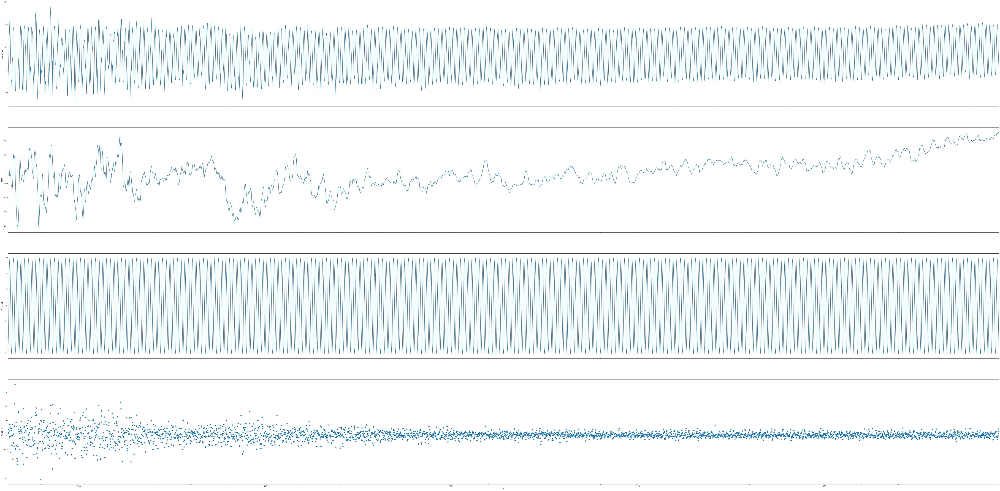

In [10]:
result_add = seasonal_decompose(data['LandAverageTemperature'], model='additive', extrapolate_trend='freq')

# Plot
fig, axes = plt.subplots(ncols=1, nrows=4, sharex=True)
result_add.observed.plot(ax=axes[0], legend=False)
axes[0].set_ylabel('Observed')
result_add.trend.plot(ax=axes[1], legend=False)
axes[1].set_ylabel('Trend')
result_add.seasonal.plot(ax=axes[2], legend=False)
axes[2].set_ylabel('Seasonal')
result_add.resid.plot(ax=axes[3], legend=False, style='o')
axes[3].set_ylabel('Residual')
plt.show()

In [11]:
result_add.resid.mean()

0.0010222721814008551

Calcolando la ***media del valore dei residui*** si può capire se  la serie è stata modelizzata nel modo corretto. 
Se questa media è diversa da 0 allora vuole dire che ci sono ancora parti della serie storica non spiegate.

Nel caso appena studiato le media è vicina allo zero, possiamo ritenere che la serie si stata modelizzata relativamente bene.

**Additive**  
Una volta scomposta la serie si procede ad analizzare le differenti componenti di essa, nello specifico si andrà a:
- [rimuovere il trend](#Detrended)
- [rimuovere la stagionalità](#Deseasonalized)
- [rimuovere il trend e la stagionalità](#Deseasoned_detrended)

##### Detrended Additive
<a id="Detrended"></a>

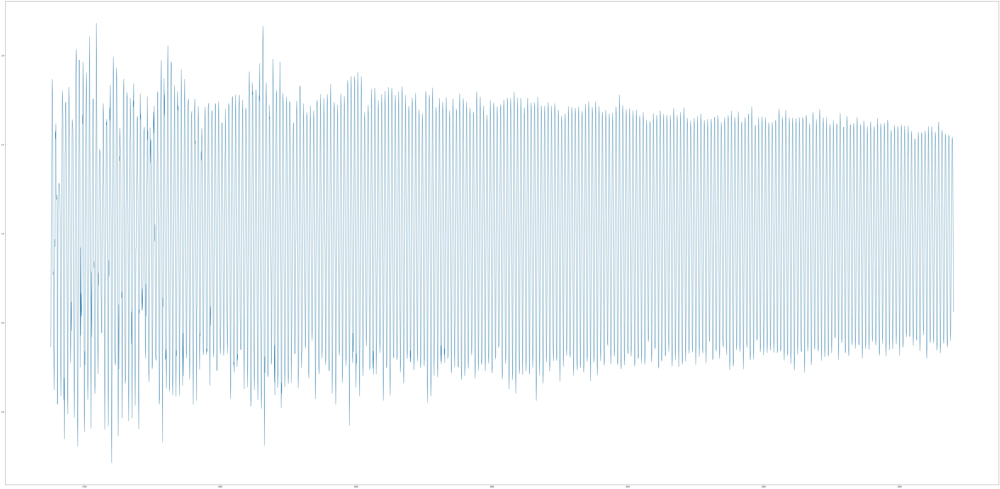

In [14]:

detrended = data.LandAverageTemperature / result_add.trend

plt.plot(data.index, detrended)
plt.show()

##### Deseasonalized Additive
<a id="Deseasonalized"></a>

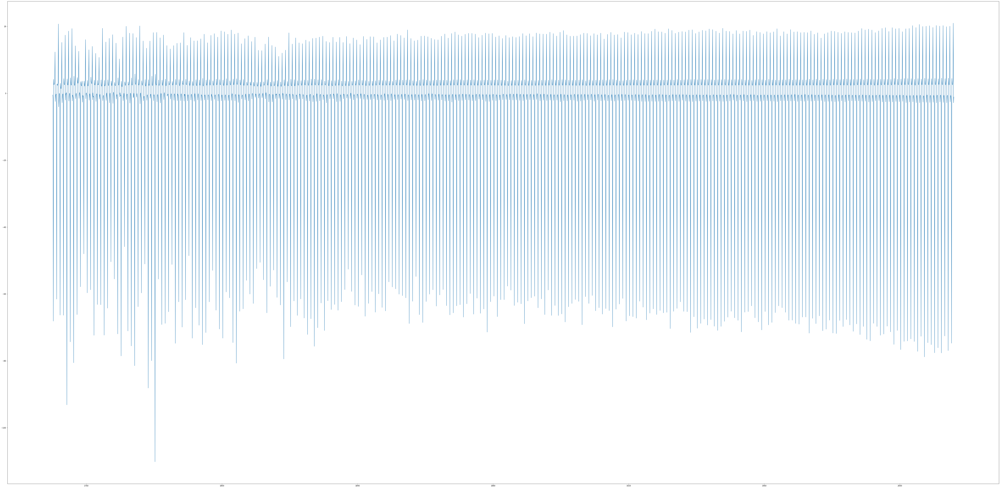

In [15]:

deseasonalized_add = data.LandAverageTemperature / result_add.seasonal

plt.plot(data.index, deseasonalized_add)
plt.show()

##### Deseasoned & Detrended Additive
<a id="Deseasoned_detrended"></a>

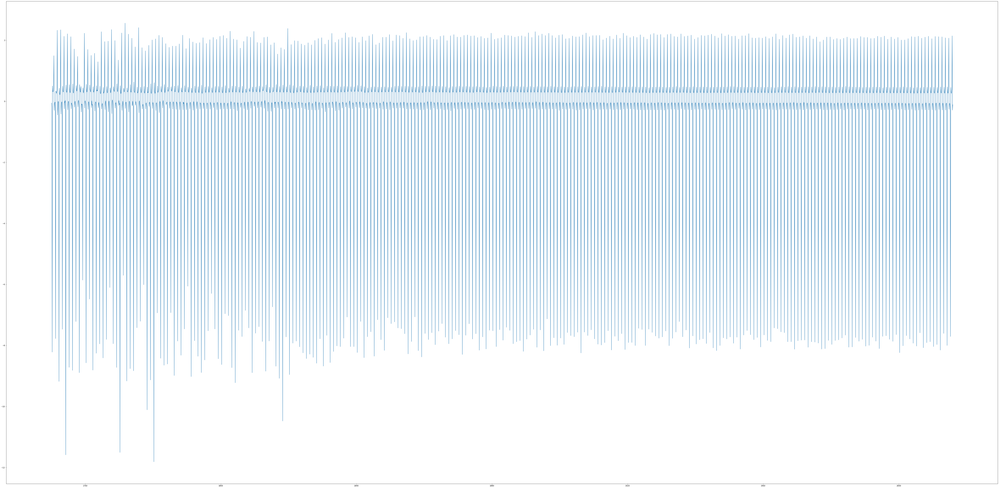

In [16]:
deseasoned = data.LandAverageTemperature / result_add.seasonal
deseasoned_detrended = deseasoned / result_add.trend

plt.plot(data.index, deseasoned_detrended)
plt.show()

####  Multiplicative Decomposition

Non è stato possobile usare l'approccio multiplativo perché sono presenti dei valori negativi nella serie.  
$$ Value = Base Level * Trend * Seasonality * Error $$

Per valutare i risultati della ***Multiplicative Decomposition*** sono stati prima individuati i valori minori di 0 e successivamente l'intera colonna è stata trasformata in valore assoluto

In [17]:
print('Di seguito i ' + str( len(data[data['LandAverageTemperature']< 0])) + ' valori minori di zero: \n\n' +
      str(data[data['LandAverageTemperature']< 0]))

Di seguito i 17 valori minori di zero: 

            LandAverageTemperature
dt                                
1754-02-01                  -1.249
1755-02-01                  -0.108
1757-01-01                  -0.276
1758-01-01                  -1.503
1760-01-01                  -0.811
1761-12-01                  -0.837
1766-01-01                  -0.793
1767-01-01                  -0.643
1768-01-01                  -2.080
1769-12-01                  -0.978
1771-02-01                  -0.274
1773-01-01                  -0.437
1774-01-01                  -0.325
1776-01-01                  -0.806
1783-01-01                  -1.431
1813-01-01                  -1.385
1838-01-01                  -0.557


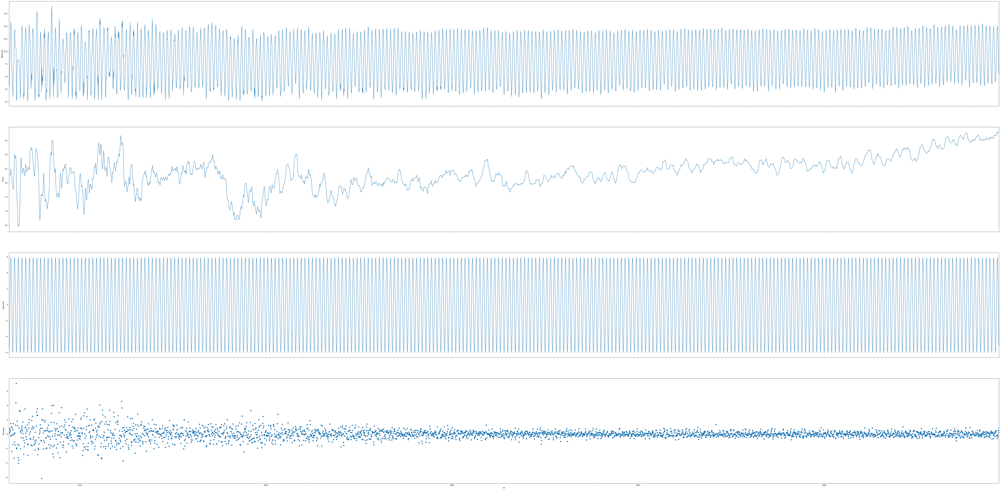

In [18]:
data_no_negative = data.copy()
data_no_negative['LandAverageTemperature'] = abs(data_no_negative['LandAverageTemperature'])
result_mul = seasonal_decompose(data_no_negative['LandAverageTemperature'], model='Multiplicative', 
                                extrapolate_trend='freq')

# Plot
fig, axes = plt.subplots(ncols=1, nrows=4, sharex=True)
result_mul.observed.plot(ax=axes[0], legend=False)
axes[0].set_ylabel('Observed')
result_mul.trend.plot(ax=axes[1], legend=False)
axes[1].set_ylabel('Trend')
result_mul.seasonal.plot(ax=axes[2], legend=False)
axes[2].set_ylabel('Seasonal')
result_mul.resid.plot(ax=axes[3], legend=False, style='o')
axes[3].set_ylabel('Residual')
plt.show()

**Multiplicative**  
Una volta scomposta la serie si procede ad analizzare le differenti componenti di essa, nello specifico si andrà a:
- [rimuovere il trend](#DetrendedMu)
- [rimuovere la stagionalità](#DeseasonalizedMu)
- [rimuovere il trend e la stagionalità](#Deseasoned_detrendedMu)

##### Detrended
<a id="DetrendedMu"></a>

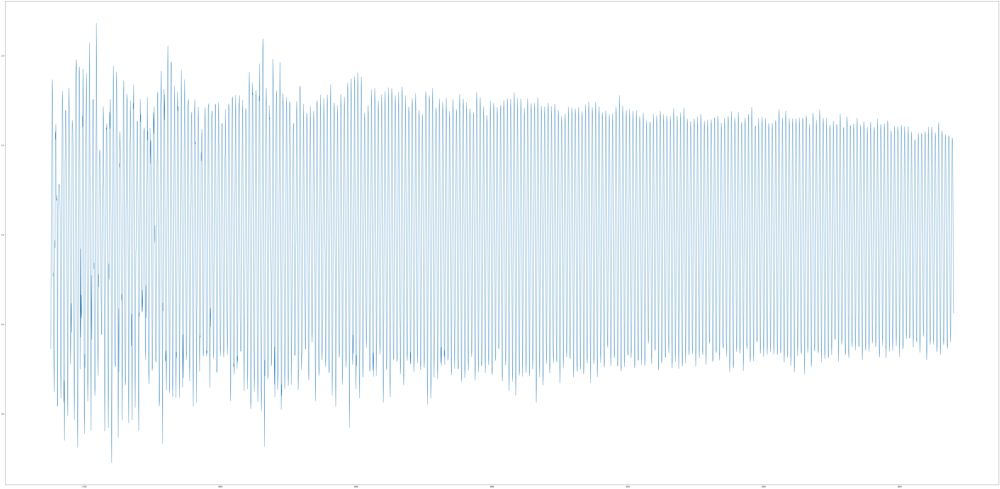

In [19]:
detrended_mul = data.LandAverageTemperature / result_mul.trend

plt.plot(data.index, detrended_mul)
plt.show()

##### Deseasonalized
<a id="DeseasonalizedMu"></a>

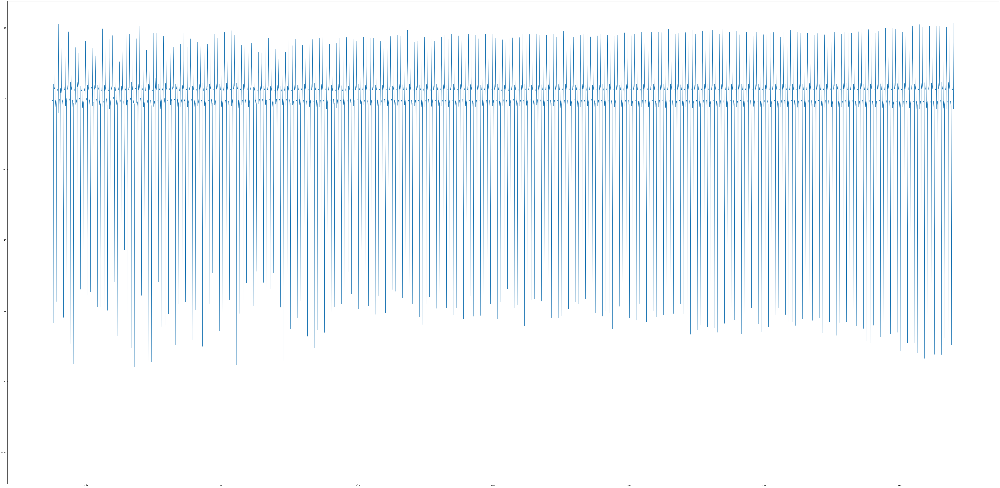

In [20]:

deseasonalized_mul = data.LandAverageTemperature / result_mul.seasonal

plt.plot(data.index, deseasonalized_mul)
plt.show()

##### Deseasoned & Detrended
<a id="Deseasoned_detrendedMu"></a>

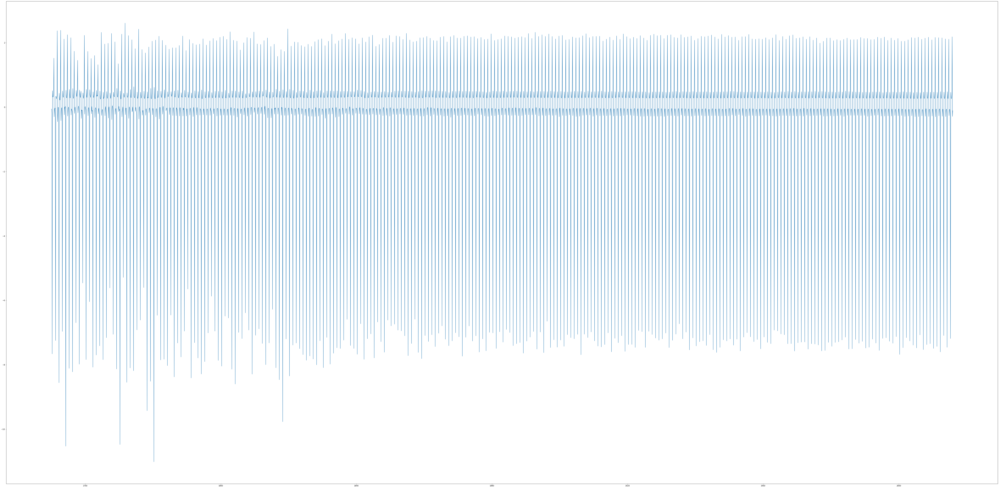

In [21]:
deseasoned = data.LandAverageTemperature / result_mul.seasonal
deseasoned_detrended_mul = deseasoned / result_mul.trend

plt.plot(data.index, deseasoned_detrended_mul)
plt.show()

In [22]:
result_mul.resid.mean(), result_add.resid.mean(), result_mul.resid.mean() - result_add.resid.mean()

(0.001022272181400845, 0.0010222721814008551, -1.0191500421363742e-17)

Sia il la decomposizione additive che multiplicative hanno un bassa media dei residui ma la differenza tra queste è minima

In [25]:
df_decompisition = data.copy()

df_decompisition['detrended_add'] = detrended
df_decompisition['deseasonalized_add'] = deseasonalized_add
df_decompisition['deseasoned_detrended_add'] = deseasoned_detrended

df_decompisition['detrended_mul'] = detrended_mul
df_decompisition['deseasonalized_mul'] = deseasonalized_mul
df_decompisition['deseasoned_detrended_mul'] = deseasoned_detrended_mul

df_decompisition.head(5)

,LandAverageTemperature,detrended_add,deseasonalized_add,deseasoned_detrended_add,detrended_mul,deseasonalized_mul,deseasoned_detrended_mul
dt,,,,,,,
1750-01-01,3.034,0.364139,-0.497605,-0.059722,0.364139,-0.503717,-0.060456
1750-02-01,3.083,0.370662,-0.568763,-0.068381,0.370662,-0.569097,-0.068421
1750-03-01,5.626,0.677577,-1.647171,-0.198380,0.677577,-1.642803,-0.197854
1750-04-01,8.490,1.024289,-68.123649,-8.218880,1.024289,-63.496977,-7.660688
1750-05-01,11.573,1.398677,4.200757,0.507691,1.398677,4.214649,0.509370


### Stazionarietà

In [35]:
result = adfuller(data.LandAverageTemperature)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')

for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

ADF Statistic: -3.925122
p-value: 0.001858
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567


Il p-value ci indica che l'ipotesi nulla deve **essere rifiutata**.  

La serie temporale è stazionaria, il suo valore **NON** è legato alla variabile ***tempo***.

Lo stesso è confermato dalla statistica **ADF** che è minore dei valori critici riportati

## Autocorrelazione 

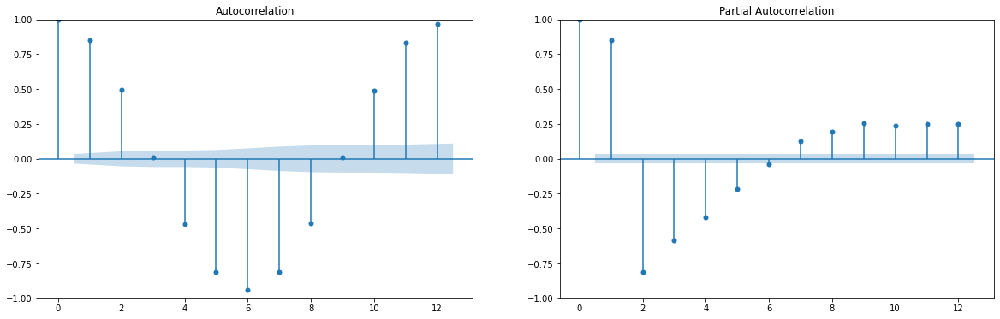

In [78]:
fig, axes = plt.subplots(1, 2, figsize=(20,6))
plot_acf(data.LandAverageTemperature.tolist(), lags=12, ax=axes[0])
plot_pacf(data.LandAverageTemperature.tolist(), lags=12, ax=axes[1])
plt.show()

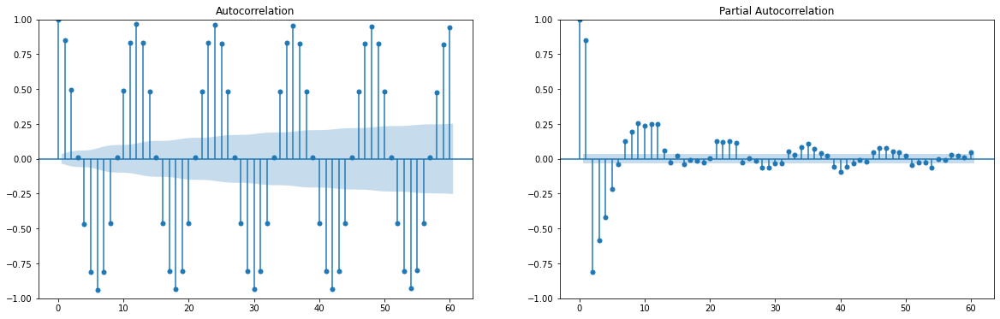

In [80]:
fig, axes = plt.subplots(1, 2, figsize=(20,6))
plot_acf(data.LandAverageTemperature.tolist(), lags=60, ax=axes[0])
plot_pacf(data.LandAverageTemperature.tolist(), lags=60, ax=axes[1])
plt.show()

## Regressione lineare

Trasformiamo il valore datetime in un indicatore che conta il numero di periodo passati dal giorno disponibile.  

__1 periodo = 1 giorno__

### Preparazione del dato

##### Creazione dei periodi

In [44]:
data.index.min()

Timestamp('1750-01-01 00:00:00')

In [45]:
diff = []
for index, row in data.reset_index().iterrows():
    diff.append((row['dt']- data.reset_index()['dt'].min()).days)
data_regr = data.reset_index().drop(columns='dt')
data_regr['periods'] = diff
data_regr = data_regr.set_index('periods')

In [46]:
y = data_regr['LandAverageTemperature']
x1 = data_regr.index

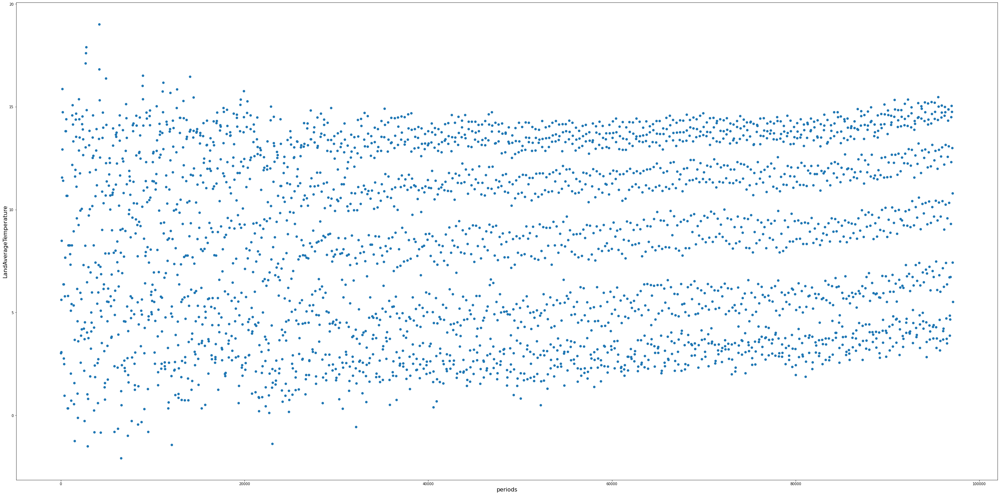

In [53]:
# Plot a scatter plot (first we put the horizontal axis, then the vertical axis)
plt.rcParams.update({'figure.figsize': (50, 25)})
plt.scatter(x1, y)
# Name the axes
plt.xlabel('periods', fontsize=16)
plt.ylabel('LandAverageTemperature', fontsize=16)
# Show the plot
plt.show()

##### Split del train e del test

In [54]:
X_train, X_test, Y_train, Y_test = train_test_split(x1, y, test_size=0.3)

##### Aggiunta della costante

In [55]:
# Add a constant. Essentially, we are adding a new column (equal in lenght to x), which consists only of 1s
x = sm.add_constant(X_train)

### Fit del modello

In [56]:
# Fit the model, according to the OLS (ordinary least squares) method with a dependent variable y and an idependent x
results = sm.OLS(Y_train, x).fit()
Y_pred_train = results.predict(x) # eseguiamo la predizione sul train set
Y_pred_test = results.predict(sm.add_constant(X_test)) # eseguiamo la predizione anche sul test set

### Rappresentazione grafica della regressione

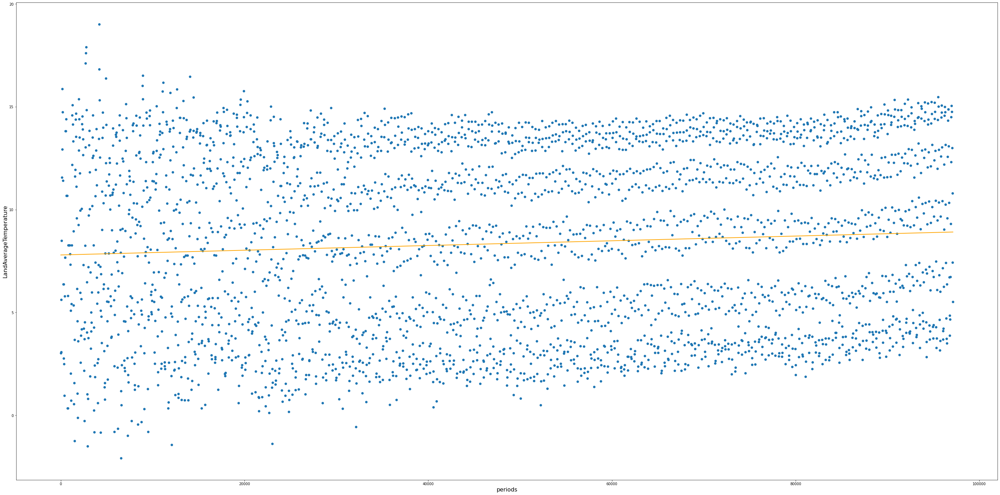

In [57]:
# Create a scatter plot
plt.scatter(x1, y)
# Define the regression equation, so we can plot it later
yhat = results.params.const + results.params.x1 * x1
# Plot the regression line against the independent variable (SAT)
plt.plot(x1, yhat, lw=2, c='orange')
# Label the axes
plt.xlabel('periods', fontsize=16)
plt.ylabel('LandAverageTemperature', fontsize=16)
plt.show()

### Valutazione del modello

#####  mean squared error

In [58]:
from sklearn.metrics import mean_squared_error

print("MSE train: %f" % mean_squared_error(Y_train, Y_pred_train))
print("MSE test: %f" % mean_squared_error(Y_test, Y_pred_test))

MSE train: 18.943368
MSE test: 19.223450


#####  Coefficiente di indeterminazione 
***r2_score***

In [59]:
from sklearn.metrics import r2_score

print("R2 train: %f" % r2_score(Y_train, Y_pred_train))
print("R2 test: %f" % r2_score(Y_test, Y_pred_test))

R2 train: 0.005465
R2 test: 0.008974


In [60]:
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              OLS Regression Results                              
==================================================================================
Dep. Variable:     LandAverageTemperature   R-squared:                       0.005
Model:                                OLS   Adj. R-squared:                  0.005
Method:                     Least Squares   F-statistic:                     12.26
Date:                    Wed, 20 Jul 2022   Prob (F-statistic):           0.000471
Time:                            15:33:55   Log-Likelihood:                -6455.5
No. Observations:                    2234   AIC:                         1.292e+04
Df Residuals:                        2232   BIC:                         1.293e+04
Df Model:                               1                                         
Covariance Type:                nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.7977      0.184     42.488      0.000       7.438       8.158
x1          1.148e-05   3.28e-06      3.502      0.000    5.05e-06    1.79e-05
==============================================================================
Omnibus:                    25950.104   Durbin-Watson:                   1.977
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              168.045
Skew:                          -0.061   Prob(JB):                     3.23e-37
Kurtosis:                       1.662   Cond. No.                     1.12e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.12e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Possiamo ricavare la funzione che sarà così composta  

$ y = 7.8 + 1.1.148e^{-05} * periods  $

E' però necessario considerare le metriche per valuare il modello. Entrambe non hanno evendenziato valori risultati positivi sulla regressione lineare appena compiuta.  
L'**r2 score** nello specifico presenta valori inferiori allo 0.3, questo ci indica che il modello può essere ritenuto non affidabile.


## Forecasting di una serie storica

In [61]:
data.index.min(), data.index.max()

(Timestamp('1750-01-01 00:00:00'), Timestamp('2015-12-01 00:00:00'))

Dunque il nostro obiettivo sarà quello di prevedere 10 anni di temperature del suolo da dal 2015-12-01 al 2025-12-01

### Addestramento del modello con auto arima

I modelli arima tengono conto di principalmente 3 componenti:
- stagionalità
- andamento/trend
- rumore dei dati/errore

Una volta tenuto conto di questi valori il pacchetto autoarima andrà ad identificare quale modello è più performante con i nostri dati utilizzando come metrica di riferimento AIC. 

Akaike Information Critera (AIC), è un metodo usato per la valutazione e il confronto tra modelli statistici, più questo indice è basso migliore sarà il modello

In [62]:
smodel = pm.auto_arima(data, start_p=1, start_q=1,
                       test='adf',
                       max_p=3, max_q=3, m=12,
                       start_P=0, seasonal=True,
                       d=None, D=1, trace=True,
                       error_action='ignore',  
                       suppress_warnings=True, 
                       stepwise=True)

smodel.summary()

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=8.90 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=9705.289, Time=0.08 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=8523.799, Time=2.18 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=4.69 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=9703.352, Time=0.07 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=9333.608, Time=0.25 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=8250.071, Time=5.03 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=15.91 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=8.67 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=8660.241, Time=4.30 sec
 ARIMA(2,0,0)(2,1,0)[12] intercept   : AIC=8244.380, Time=5.90 sec
 ARIMA(2,0,0)(1,1,0)[12] intercept   : AIC=8519.039, Time=2.44 sec
 ARIMA(2,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=22.21 sec
 ARIMA(2,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=11.44 sec
 ARIMA(3,0,0)(2,1,0)[12] intercept   : AIC=824

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                                   y   No. Observations:                 3192
Model:             SARIMAX(3, 0, 2)x(2, 1, [], 12)   Log Likelihood               -4108.499
Date:                             Wed, 20 Jul 2022   AIC                           8232.997
Time:                                     15:43:34   BIC                           8281.514
Sample:                                          0   HQIC                          8250.397
                                            - 3192                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3596      0.061     22.166      0.000       1.239       1.480
ar.L2         -0.9875      0.087    -11.287      0.000      -1.159      -0.816
ar.L3          0.1809      0.031      5.922      0.000       0.121       0.241
ma.L1         -1.0292      0.059    -17.587      0.000      -1.144      -0.914
ma.L2          0.7006      0.065     10.795      0.000       0.573       0.828
ar.S.L12      -0.6059      0.010    -58.521      0.000      -0.626      -0.586
ar.S.L24      -0.2917      0.009    -31.692      0.000      -0.310      -0.274
sigma2         0.7744      0.009     84.749      0.000       0.757       0.792
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):              7300.10
Prob(Q):                              0.94   Prob(JB):                         0.00
Heteroskedasticity (H):               0.06   Skew:                             0.35
Prob(H) (two-sided):                  0.00   Kurtosis:                        10.39
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

il modello più performante è:  
ARIMA(3,0,2)(2,1,0)[12]  
AIC = 8232.997

Viene diviso il dataset in due subset si vogliono predirre gli ultimi 2 anni

In [63]:
future = data[-24:]
past = data[:-24]

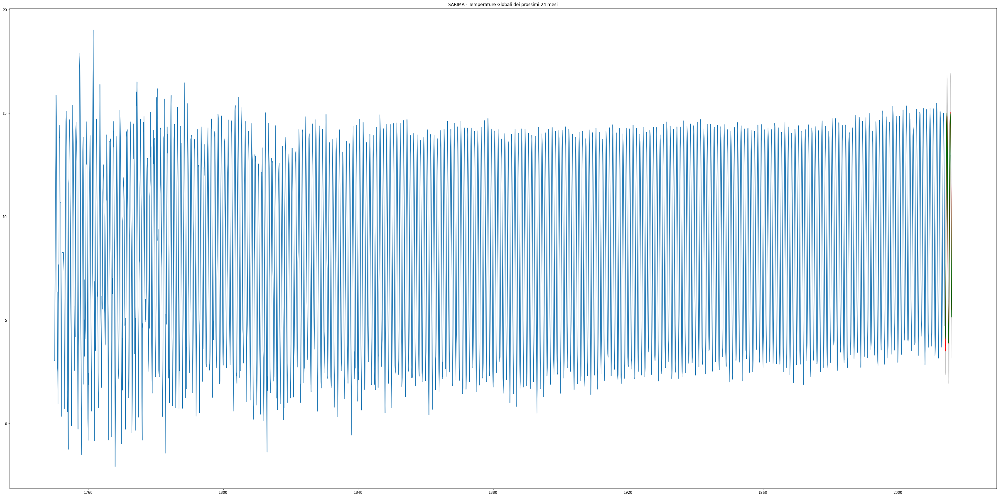

In [64]:
n_periods = 24
fitted, confint = smodel.predict(n_periods=n_periods, return_conf_int=True)
index_of_fc = pd.date_range(past.index[-1], periods=n_periods, freq='M')

# make series for plotting purpose
fitted_series = pd.Series(fitted, index=index_of_fc)
lower_series = pd.Series(confint[:, 0], index=index_of_fc)
upper_series = pd.Series(confint[:, 1], index=index_of_fc)

# plot

plt.plot(past)
plt.plot(future, color='red')

plt.plot(fitted_series, color='darkgreen')
plt.fill_between(lower_series.index, 
                 lower_series, 
                 upper_series, 
                 color='k', alpha=.15)

plt.title("SARIMA - Temperature Globali dei prossimi 24 mesi")
plt.show()

Verifichiamo adesso come le eventuali differenze tra i valori reali e valori preditti.
Creiamo un df contenente appunto valori reali e valori preditti e successivamente per ogni periodo (mese) calcoliamo la differenza

In [65]:
df_fitted_serie = pd.DataFrame({'dt':fitted_series.index, 'LandAverageTemperature':fitted_series.values})

In [66]:
df_fitted_serie['dt'] = df_fitted_serie['dt'] + dt.timedelta(1)
compare = df_fitted_serie.merge(future.reset_index(), on = 'dt')

In [67]:
compare['delta'] = abs(compare['LandAverageTemperature_x'] - compare['LandAverageTemperature_y'])

(<AxesSubplot:>,
            delta
 count  24.000000
 mean    0.211616
 std     0.186601
 min     0.003841
 25%     0.078546
 50%     0.156874
 75%     0.295126
 max     0.795550)

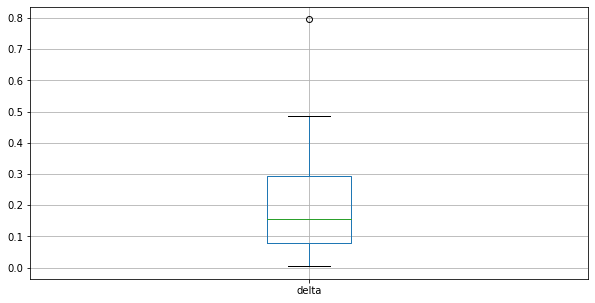

In [68]:
compare[['delta']].boxplot(figsize=(10,5)), compare[['delta']].describe()

La maggior parte dei casi sembrano avere un errore compreso da 0.1 e 0.2

### Predizione delle temperature dei prossimi 10 anni
Si calcolano i successivi 10 anni di temperature, considerando che un anno ha 12 mesi e il _periodo_ nel nostro dataframe è uguale a 1 mese allora il numero di periodi ricercato è 12 * 10 = 120

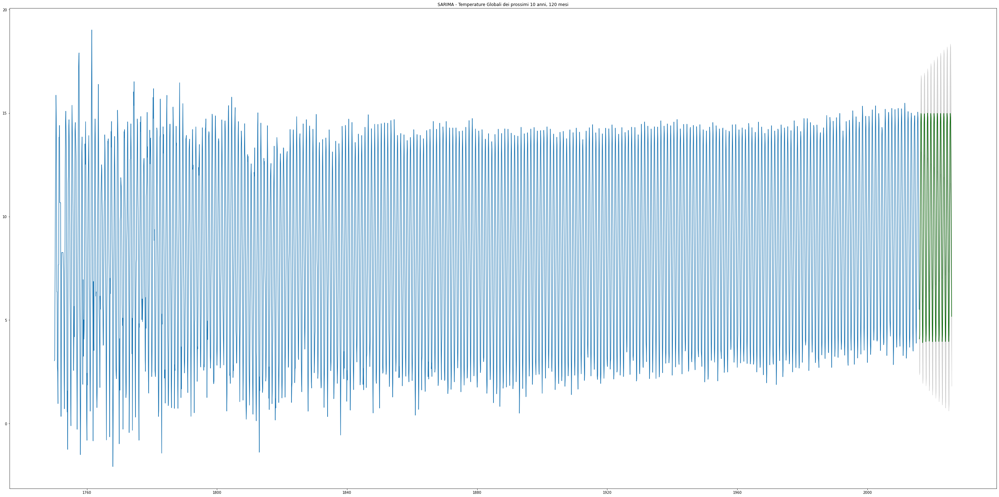

In [69]:
n_periods = 12 * 10
fitted, confint = smodel.predict(n_periods=n_periods, return_conf_int=True)
index_of_fc = pd.date_range(data.index[-1], periods=n_periods, freq='M')

# make series for plotting purpose
fitted_series = pd.Series(fitted, index=index_of_fc)
lower_series = pd.Series(confint[:, 0], index=index_of_fc)
upper_series = pd.Series(confint[:, 1], index=index_of_fc)

# plot

plt.plot(data)
#plt.plot(future, color='red')

plt.plot(fitted_series, color='darkgreen')
plt.fill_between(lower_series.index, 
                 lower_series, 
                 upper_series, 
                 color='k', alpha=.15)

plt.title("SARIMA - Temperature Globali dei prossimi 10 anni, 120 mesi")
plt.show()

In [70]:
df_fitted_serie = pd.DataFrame({'dt':fitted_series.index, 'LandAverageTemperature':fitted_series.values}).set_index('dt')
df_fitted_serie

,LandAverageTemperature
dt,
2015-12-31,4.088679
2016-01-31,4.295550
2016-02-29,6.517846
2016-03-31,9.295591
2016-04-30,12.319733
...,...
2025-07-31,14.800384
2025-08-31,13.062980
2025-09-30,10.571764


In [73]:
df_fitted_serie.describe(), data.describe()

(       LandAverageTemperature
 count              120.000000
 mean                 9.728968
 std                  4.043398
 min                  3.909452
 25%                  6.195606
 50%                  9.948461
 75%                 13.428849
 max                 14.997291,
        LandAverageTemperature
 count             3192.000000
 mean                 8.375063
 std                  4.377168
 min                 -2.080000
 25%                  4.326500
 50%                  8.599000
 75%                 12.547000
 max                 19.021000)

Le temperature predette sembrano essere coerenti con le temperature presenti nel dataset
